# <font color = 'Blue'> ORL Clustering

<hr>


In this excerise, we are trying to cluster ORL Dataset.  

For this task, we are going to use four major clustering algorithms : Hierarchical, DBSCAN, Kmeans, and Spectral Clustering.

A set of hyperparameters and optiones are pre-defined to make a unique clustering algorithms for our task. 

<hr> 
    
Everything required for this exercise is available at : 
    
    
   
***GitHub***  : <a href = "https://github.com/A-M-Kharazi/Special-Topics-in-DataMining-TMU.git" > Main (class) repo </a> 
    &nbsp;&nbsp;&nbsp;
    <a href = "" > This Document page</a>
    
    
***GoogleDrive*** : <a href = "" > Not available ATM  </a>

#  <font color = 'Blue'> Import Libraries

<hr>


These libraries are essential to our code so please make sure that all of them are installed or  if necessary
<code> pip install </code> them.

- numpy is used for primal data operation


- matplotlib is used for data visualization


- sklearn is the base of clustering algorithms

    
- Scipy is used for special matrix calculation (sparse matrix)
    

- mplot3d is to plot 3D data
    
    
- PCA is Principal Component Analysis and is used to help plot our data since IRIS features are in 4D space.



In [1]:
import numpy as np
import pandas as pd
import random
import matplotlib.pyplot as plt
import sklearn.datasets
from scipy.spatial import distance_matrix
from sklearn.cluster import AgglomerativeClustering
from sklearn.cluster import DBSCAN
from sklearn.cluster import KMeans
from sklearn import metrics

from sklearn.linear_model import orthogonal_mp as OMP
import networkx as nx


# <font color = 'Blue'> Import data

<hr>


Making use of sklean library, we can use its fetch_olivetti_faces method to obtain our ORL dataset. If necessary, use your our method to import data. ORL is a dictionary containing data, images, target and a Describtion. 

In summary: ORL dataset contains 400 samples of 40 people, therefore 40 clusters is needed. Each sample is a image of 64x64, which later is flatten and saved in data. You can check the ground truth for better visualization of this dataset.

In [2]:
ORL = sklearn.datasets.fetch_olivetti_faces()

data = ORL['data']
description = ORL['DESCR']
target = ORL['target']
images = ORL['images']

# <font color = 'Blue'> ORL Description

<hr>

In [3]:
print(description)

.. _olivetti_faces_dataset:

The Olivetti faces dataset
--------------------------

`This dataset contains a set of face images`_ taken between April 1992 and 
April 1994 at AT&T Laboratories Cambridge. The
:func:`sklearn.datasets.fetch_olivetti_faces` function is the data
fetching / caching function that downloads the data
archive from AT&T.

.. _This dataset contains a set of face images: https://cam-orl.co.uk/facedatabase.html

As described on the original website:

    There are ten different images of each of 40 distinct subjects. For some
    subjects, the images were taken at different times, varying the lighting,
    facial expressions (open / closed eyes, smiling / not smiling) and facial
    details (glasses / no glasses). All the images were taken against a dark
    homogeneous background with the subjects in an upright, frontal position 
    (with tolerance for some side movement).

**Data Set Characteristics:**

    =================   =====================
    Classes    

# <font color = 'Blue'> Visualize Data 

<hr>

In this section we are visualizing the ground truth. We are also using PCA(2) to plot each sample in a 2D-plane which will make visualizing the graph much simpler. 

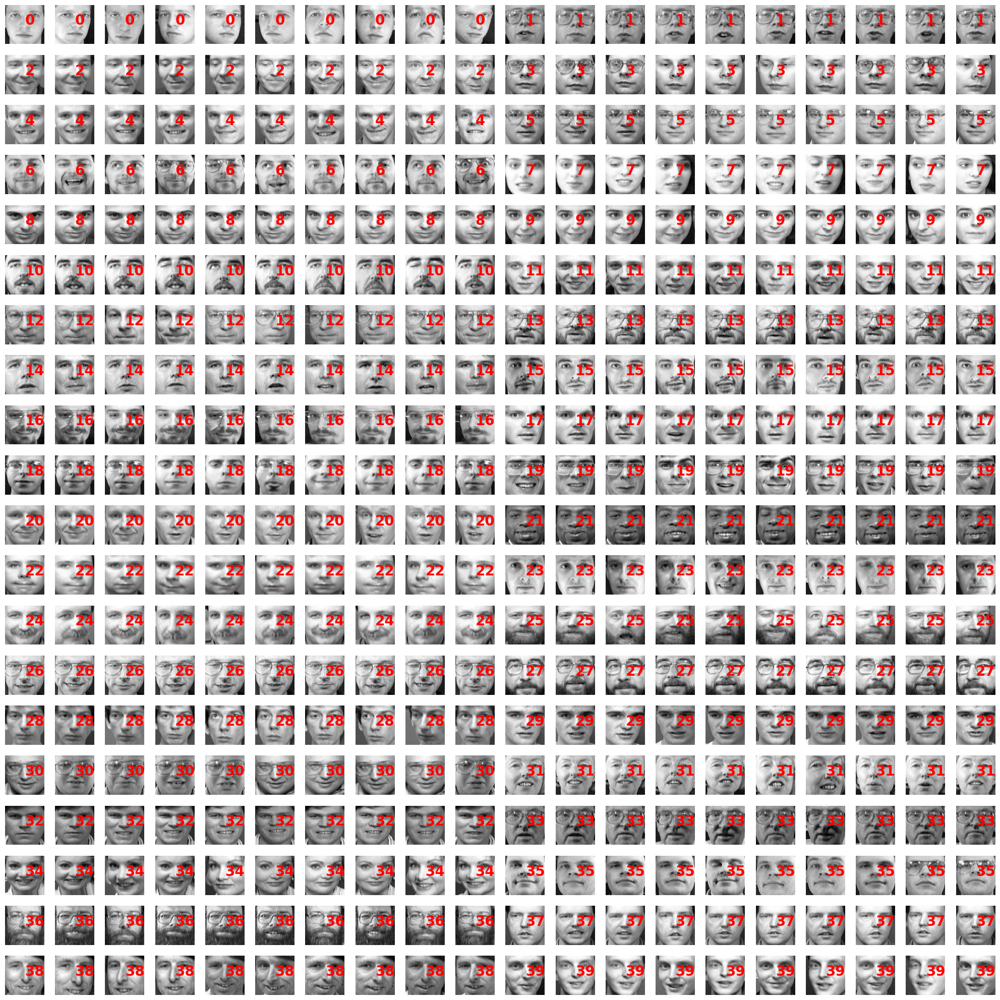

In [5]:
# Ground Truth


fig = plt.figure(figsize=(20,20))
indx = 1
for img in images:
    ax = fig.add_subplot(20,20,indx)
    ax.imshow(img, cmap = 'gray')
    ax.grid(False)
    ax.axis('off')
    # add label aka target aka cluster 
    ax.text(img.shape[0]/2, img.shape[1]/2, str(target[indx-1]), fontsize = 20, color = 'red', fontweight='bold')
    indx+=1
fig.tight_layout()
plt.show()

#  <font color = 'Blue'> Hierarchical Clustering (Complete Link - L2)

<hr>

    
Using sklearn AgglomerativeClustering algorithm, we can perform hierarchical clustering on our dataset. We are using 'l2' hierarchical clustering with 'complete' linkage method.

In [6]:
# Create the model

clustering = AgglomerativeClustering(n_clusters=40, affinity='l2', linkage='complete')

# Fit the model on dataset

clustering.fit(data)

# Clustering labels

Hierarchical_labels = clustering.labels_


##  <font color = 'Blue'> Visualizing the Results and lables


The result of hierarchical clustering can be acquired  using <code>.labels_</code> or other methods.

These labels are then assigned a color and visualized in a scatter plot using matplotlib.

In [7]:
# Result , containg data, target and estimated cluster. 
Hierarchical_results = pd.DataFrame({'data': data.tolist(),'y' : target, 'yhat': Hierarchical_labels})
# Sort the result so visulization is simpler 
# Sort based on the y estimate aka yhat 
# Result is the new cluster visualization
Hierarchical_results = Hierarchical_results.sort_values(by='yhat')
new_images = Hierarchical_results['data']
new_targets = np.array(Hierarchical_results['yhat'])

In [8]:
# rand score
Hierarchical_rc = metrics.rand_score(target, Hierarchical_labels)

# Normalized Mutual Information
Hierarchical_nmi = metrics.normalized_mutual_info_score(target, Hierarchical_labels)

# Fowlkes-Mallows scores
Hierarchical_fm  = metrics.fowlkes_mallows_score(target, Hierarchical_labels)


print(f'rand score : {Hierarchical_rc}')
print(f'Normalized Mutual Information score : {Hierarchical_nmi}')
print(f'Fowlkes-Mallows score : {Hierarchical_fm}')

rand score : 0.9632456140350877
Normalized Mutual Information score : 0.7510724338565746
Fowlkes-Mallows score : 0.3877616470269056


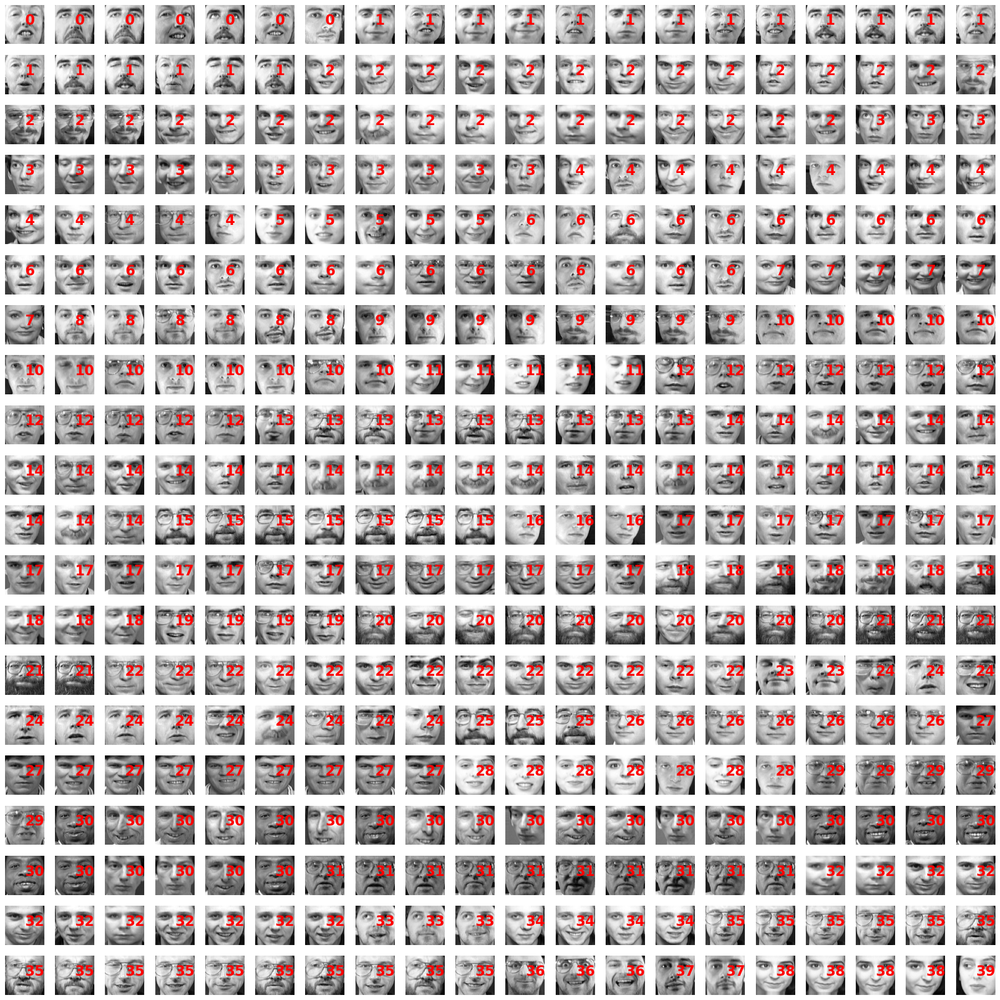

In [9]:
# Hierarchical result

fig = plt.figure(figsize=(20,20))
indx = 1
for img in new_images:
    img = np.array(img).reshape(64,64)
    ax = fig.add_subplot(20,20,indx)
    ax.imshow(img, cmap = 'gray')
    ax.grid(False)
    ax.axis('off')
    # add label aka target aka cluster 
    ax.text(img.shape[0]/2, img.shape[1]/2, str(new_targets[indx-1]), fontsize = 20, color = 'red', fontweight='bold')
    indx+=1
fig.tight_layout()
plt.show()

#  <font color = 'Blue'> DBSSCAN Clustering

<hr>

Using sklearn DBSCAN algorithm, we can perform dbscan clustering on our dataset. Hyperparameters are set at the beginning of this exercise and different values in hyperparameters can result in different clusters.  

In [10]:
# Create the model

clustering = DBSCAN(eps=7.5, min_samples= 3)

# Fit the model on dataset

clustering.fit(data)

# Clustering labels

DBSCAN_labels = clustering.labels_

##  <font color = 'Blue'> Visualizing the Results and lables
    
Just like hierarchical clustering, clusters can be acquired using <code>.labels_</code>.

In [11]:
# Result , containg data, target and estimated cluster. 
DBSCAN_results = pd.DataFrame({'data': data.tolist(),'y' : target, 'yhat': DBSCAN_labels})
# Sort the result so visulization is simpler 
# Sort based on the y estimate aka yhat 
# Result is the new cluster visualization
DBSCAN_results = DBSCAN_results.sort_values(by='yhat')
new_images = DBSCAN_results['data']
new_targets = np.array(DBSCAN_results['yhat'])

In [12]:
# rand score
DBSCAN_rc = metrics.rand_score(target, DBSCAN_labels)

# Normalized Mutual Information
DBSCAN_nmi = metrics.normalized_mutual_info_score(target, DBSCAN_labels)

# Fowlkes-Mallows scores
DBSCAN_fm  = metrics.fowlkes_mallows_score(target, DBSCAN_labels)


print(f'rand score : {DBSCAN_rc}')
print(f'Normalized Mutual Information score : {DBSCAN_nmi}')
print(f'Fowlkes-Mallows score : {DBSCAN_fm}')

rand score : 0.7731077694235589
Normalized Mutual Information score : 0.645150373185517
Fowlkes-Mallows score : 0.2154868209451869


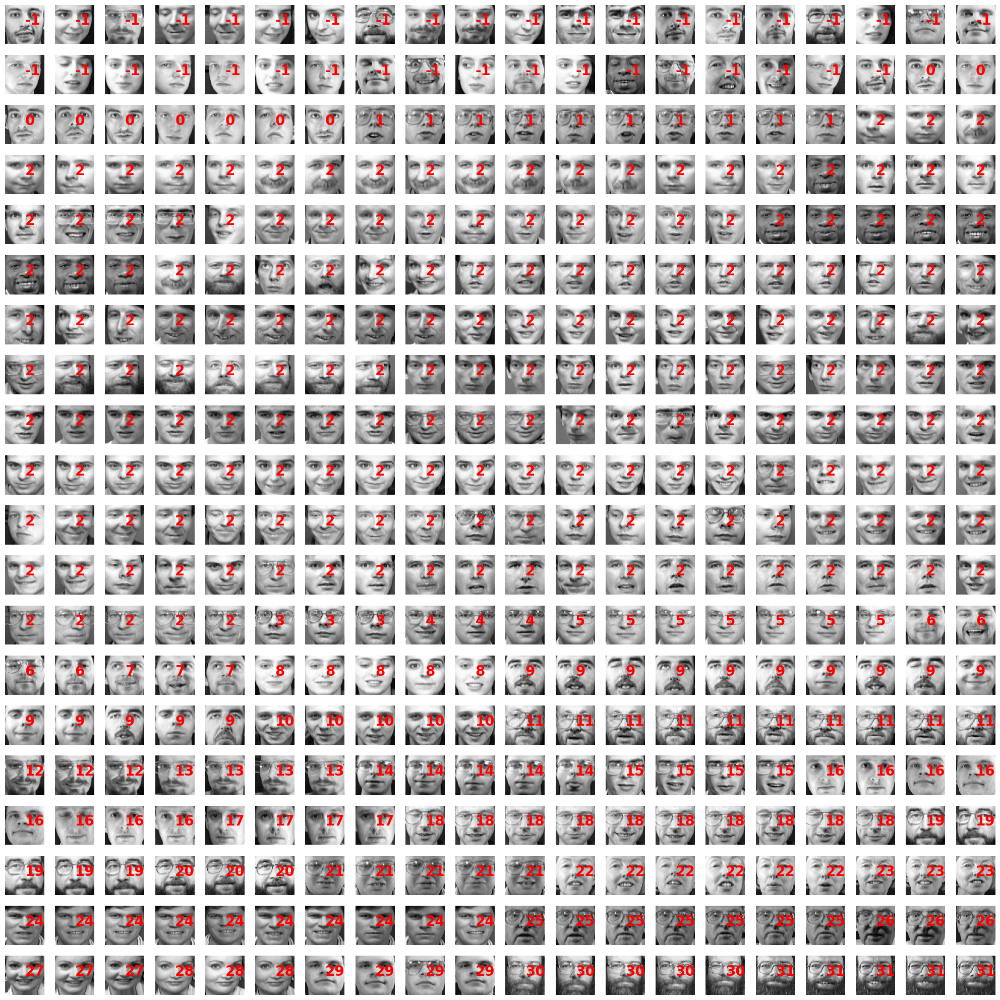

In [13]:
# DBSCAN result

fig = plt.figure(figsize=(20,20))
indx = 1
for img in new_images:
    img = np.array(img).reshape(64,64)
    ax = fig.add_subplot(20,20,indx)
    ax.imshow(img, cmap = 'gray')
    ax.grid(False)
    ax.axis('off')
    # add label aka target aka cluster 
    ax.text(img.shape[0]/2, img.shape[1]/2, str(new_targets[indx-1]), fontsize = 20, color = 'red', fontweight='bold')
    indx+=1
fig.tight_layout()
plt.show()

# <font color = 'Blue'> Kmeans Clustering

<hr>
    
Using sklearn KMeans algorithm, we can perform kmeans clustering on our dataset. 

In [14]:
# Create the model

clustering = KMeans(n_clusters=  40)

# Fit the model on dataset

clustering.fit(data)

# Clustering labels

Kmeans_labels = clustering.labels_

##  <font color = 'Blue'> Visualizing the Results and lables
    
Just like previous clustering, clusters can be acquired using <code>.labels_</code>.

In [15]:
# Result , containg data, target and estimated cluster. 
Kmeans_results = pd.DataFrame({'data': data.tolist(),'y' : target, 'yhat': Kmeans_labels})
# Sort the result so visulization is simpler 
# Sort based on the y estimate aka yhat 
# Result is the new cluster visualization
Kmeans_results = Kmeans_results.sort_values(by='yhat')
new_images = Kmeans_results['data']
new_targets = np.array(Kmeans_results['yhat'])

In [16]:
# rand score
Kmeans_rc = metrics.rand_score(target, Kmeans_labels)

# Normalized Mutual Information
Kmeans_nmi = metrics.normalized_mutual_info_score(target, Kmeans_labels)

# Fowlkes-Mallows scores
Kmeans_fm  = metrics.fowlkes_mallows_score(target, Kmeans_labels)


print(f'rand score : {Kmeans_rc}')
print(f'Normalized Mutual Information score : {Kmeans_nmi}')
print(f'Fowlkes-Mallows score : {Kmeans_fm}')

rand score : 0.9731704260651629
Normalized Mutual Information score : 0.7815527703641034
Fowlkes-Mallows score : 0.47041768410729173


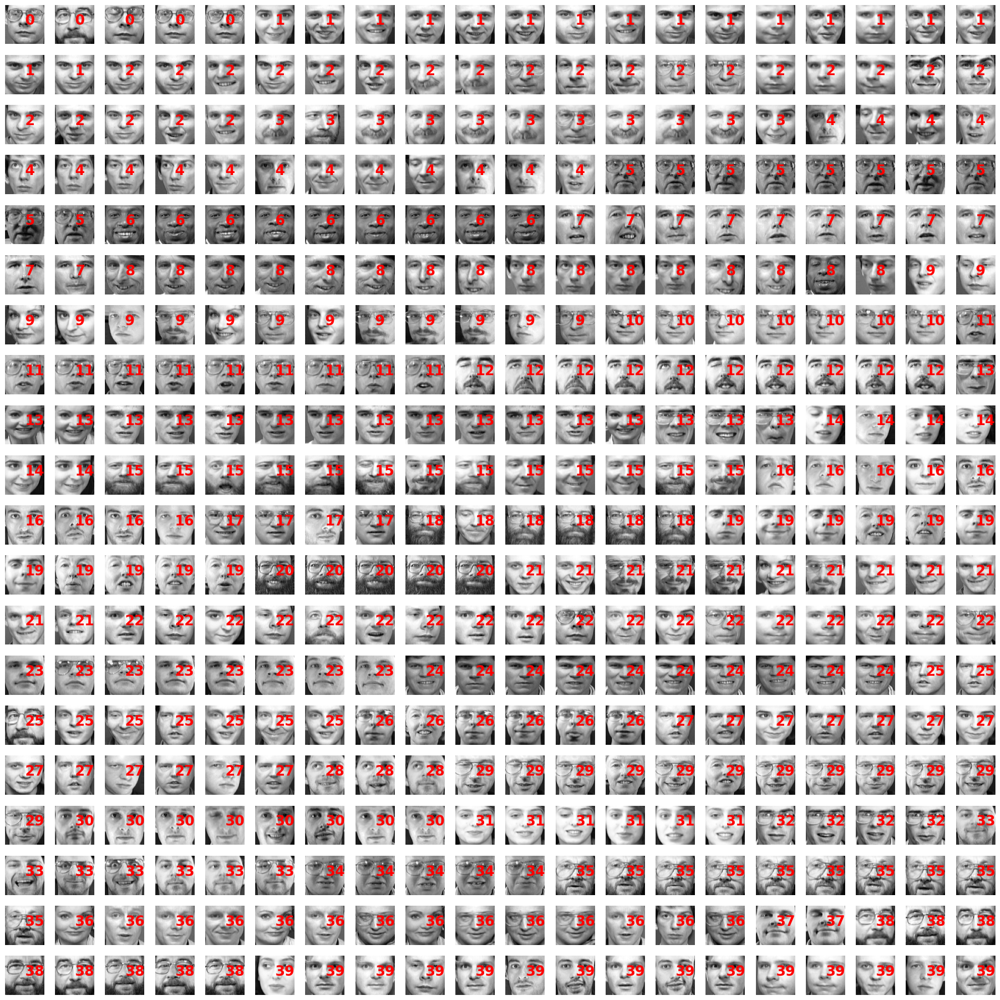

In [17]:
# Kmeans result

fig = plt.figure(figsize=(20,20))
indx = 1
for img in new_images:
    img = np.array(img).reshape(64,64)
    ax = fig.add_subplot(20,20,indx)
    ax.imshow(img, cmap = 'gray')
    ax.grid(False)
    ax.axis('off')
    # add label aka target aka cluster 
    ax.text(img.shape[0]/2, img.shape[1]/2, str(new_targets[indx-1]), fontsize = 20, color = 'red', fontweight='bold')
    indx+=1
fig.tight_layout()
plt.show()

# <font color = 'Blue'> Spectral Clustering from scratch

<hr>

This is a special type of clusterin and requires a few steps to complete its implementation. We are not using the sklearn SpectralClustering package, therefore this clustering method is written from scratch. 

There are a few steps which we need to follow :


**Note : The algorithm used for spectral can be found at Data Mining and Analysis_ Fundamental Concepts and Algorithms [Zaki & Meira 2014-05-12] Spectral Clustering page 459**

##  <font color = 'Blue'> 1. Construct Similarity matrix 

This is essentially our graph represented in a matrix. We need to create a similarity between data point (sample).  There are various methods to do so, such as :  RBF, KNN, OMP , etc. 

Since most of our methods work around distance matrix, we can make use of scipy to obtain such matrix.


In [18]:
# Pariwise distance matrix between x_i,x_j where x_i and x_j are both in data (i,j : 1 2 ... N)
# It returns the || X_i - X_j ||_2
# It is more practical to use its squared value
distance = distance_matrix(data,data)**2

### <font color = 'Blue'> 1.1 Similarity matrix using RBF

$$
W_{i,j} = \begin{cases} 
\exp^{(\frac{-||x_i-x_j||_2^2}{\sigma})} \hspace{5mm} if \hspace{3mm} \exp^{(\frac{-||x_i-x_j||_2^2}{\sigma})} > \delta \\
0 \hspace{2.5cm} O.W
\end{cases}
\hspace{3cm}
W\in R^{N\times N}
$$

where you can choose these $\sigma$ and $\delta$ manually. They are usally set to be the mean distance.

Since $W_{i,i}$ is 1 and we don't have loops, we replace them with 0.

In [19]:
W_rbf = np.zeros((data.shape[0],data.shape[0]))
gamma = 1/np.mean(distance)
# delta is obtained manually
# The method used to obtain delta is:
# First consider delta = 0 and calculate W_rbf
# Then set delta as np.mean(W_rbf - np.diag([1 for i in range(400)]))
# Calculate W_rbf again using the new delta
delta = 0.39468645906616884

for i in range(data.shape[0]):
    for j in range(data.shape[0]):
        if np.exp(-1*(gamma)*distance[i][j]) > delta:
            W_rbf[i][j] = np.exp(-1*(gamma)*distance[i][j])
            # W_i,i = 0
            if i==j:
                W_rbf[i][j] = 0
            

#### <font color = 'Blue'> Visualization using NetworkX

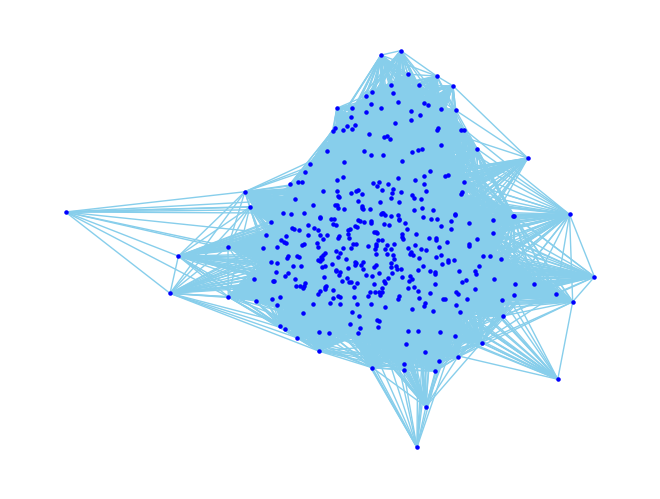

In [20]:
G =  nx.Graph()
for i in range(data.shape[0]):
    for j in range(data.shape[0]):
        if W_rbf[i][j] !=0 :
            G.add_edge(i,j)
nx.draw(G, edge_color='skyblue', node_color='blue', node_size = 5)

### <font color = 'Blue'> 1.2 Similarity matrix using KNN

Consider K nearest neighbours problem. The similarity matrix using KNN is as follow :

$$
N_k(X_i) = \left\{X_j | X_j\text{  is within k nearest neighbours of X_i}\right\}
$$

Using the method above, we can sort each row of distance matrix using np.sort; Then find the KNN and their respected indices. Since there is a 0 in distance matrix (distance of $X_i$ with $X_i$), we ignore the 0 case.  N is the KNN indices matrix.

$$
\bar{W_{i,j}} =  \begin{cases} 
\bar{W_{i,j}} \hspace{5mm} if \hspace{3mm} X_j \in N_k(X_i) \\
0 \hspace{2.5cm} O.W
\end{cases}
$$

and $\bar{W_{i,j}}$ can be $1$ or we can use weighted values such as $\exp^{(\frac{-||x_i-x_j||_2^2}{\sigma})}$.

The problem is that $\bar{W}$ is not symmetric; Therfore :

$$
W_{i,j} = \frac{\bar{W_{i,j}} + \bar{W_{j,i}}}{2}
$$

In [21]:
N = []
K = 5

# Step 1 : Find N 

for i in range(data.shape[0]):
    # sort distance matrix on data sample i
    sorted_d = np.sort(distance[i])
    knn_distance = sorted_d[:K+1]
    # find index of each distance
    index = []
    for _d in knn_distance:
        # ignore _d == 0
        if _d == 0:
            continue
        for j in range(data.shape[0]):
            if distance[i][j] == _d:
                index.append(j)
    
    # append index to N
    N.append(index)
    
# Step 2 : construct Wbar

Wbar = np.zeros((data.shape[0],data.shape[0]))

for i in range(data.shape[0]):
    for j in range(data.shape[0]):
        if j in N[i]:
            # define a weight
            #Wbar[i][j] = 1
            Wbar[i][j] = np.exp(-1*gamma*distance[i][j])
            

# Step 3 : Similarity matrix using KNN : W
W_knn = np.zeros((data.shape[0],data.shape[0]))
for i in range(data.shape[0]):
    for j in range(data.shape[0]):
        W_knn[i][j] = (Wbar[i][j] + Wbar[j][i])/2
        

#### <font color = 'Blue'> Visualization using NetworkX

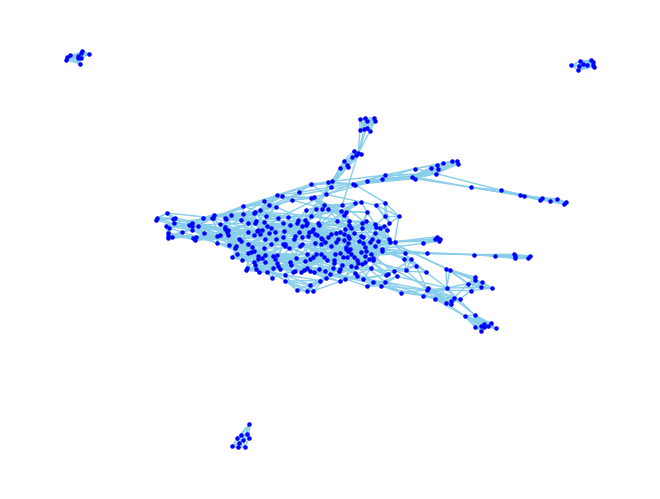

In [22]:
G =  nx.Graph()
for i in range(data.shape[0]):
    for j in range(data.shape[0]):
        if W_knn[i][j] !=0 :
            G.add_edge(i,j)
nx.draw(G, edge_color='skyblue', node_color='blue', node_size = 5)

### <font color = 'Blue'> 1.3 Similarity matrix using OMP

In [23]:
# Don't know this part . using a different version of KNN (just a temporary approach)

N = []
K = 5

# Step 1 : Find N 

for i in range(data.shape[0]):
    # sort distance matrix on data sample i
    sorted_d = np.sort(distance[i])
    knn_distance = sorted_d[:K+1]
    # find index of each distance
    index = []
    for _d in knn_distance:
        # ignore _d == 0
        if _d == 0:
            continue
        for j in range(data.shape[0]):
            if distance[i][j] == _d:
                index.append(j)
    
    # append index to N
    N.append(index)
    
# Step 2 : construct Wbar

Wbar = np.zeros((data.shape[0],data.shape[0]))

for i in range(data.shape[0]):
    for j in range(data.shape[0]):
        if j in N[i]:
            # define a weight
            Wbar[i][j] = 1
            #Wbar[i][j] = np.exp(-1*gamma*distance[i][j])
            

# Step 3 : Similarity matrix using KNN : W
W_omp= np.zeros((data.shape[0],data.shape[0]))
for i in range(data.shape[0]):
    for j in range(data.shape[0]):
        W_omp[i][j] = (Wbar[i][j] + Wbar[j][i])/2
        

#### <font color = 'Blue'> Visualization using NetworkX

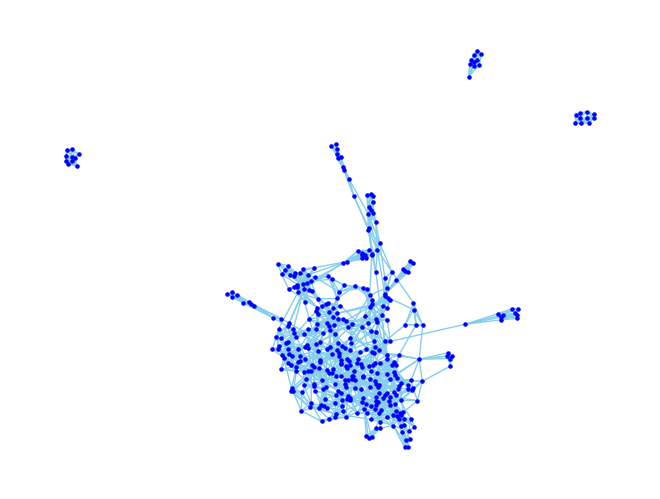

In [24]:
G =  nx.Graph()
for i in range(data.shape[0]):
    for j in range(data.shape[0]):
        if W_omp[i][j] !=0 :
            G.add_edge(i,j)
nx.draw(G, edge_color='skyblue', node_color='blue', node_size = 5)

## <font color = 'Blue'> 2.  Compute Laplacian

To Compute Laplacian, we need to calculate Degree matrix :

$$
D_i = \sum_{j=1}^{N} W_{i,j}
$$

Using D, we can calculate Laplacian matrix via :

$$
L = D - W
$$

and 

$$ 
L^s = D^{-\frac{1}{2}} L D^{-\frac{1}{2}} \hspace{1cm} L^a = D^{-1} L
$$

In [25]:
# Degree using rbf similarity matrix

Degree_rbf = np.zeros((data.shape[0],data.shape[0]))

for i in range(data.shape[0]):
    d = 0
    for j in range(data.shape[0]):
        d+= W_rbf[i][j]
    Degree_rbf[i][i] = d


# Degree using KNN similarity  matrix

Degree_knn = np.zeros((data.shape[0],data.shape[0]))

for i in range(data.shape[0]):
    d = 0
    for j in range(data.shape[0]):
        d+= W_knn[i][j]
    Degree_knn[i][i] = d

# Degree using OMP similarity matrix

Degree_omp = np.zeros((data.shape[0],data.shape[0])) 

for i in range(data.shape[0]):
    d = 0
    for j in range(data.shape[0]):
        d+= W_omp[i][j]
    Degree_omp[i][i] = d


In [26]:
# Laplacian using rbf 

L_rbf = Degree_rbf -  W_rbf

L_rbf_a = np.matmul(np.linalg.inv(Degree_rbf), L_rbf)
L_rbf_s = np.matmul(
    np.matmul(np.sqrt(np.linalg.matrix_power(Degree_rbf,-1)), L_rbf)
    ,np.sqrt(np.linalg.matrix_power(Degree_rbf,-1)))

# Laplacian using KNN

L_knn = Degree_knn -  W_knn

L_knn_a = np.matmul(np.linalg.inv(Degree_knn), L_knn)
L_knn_s = np.matmul(
    np.matmul(np.sqrt(np.linalg.matrix_power(Degree_knn,-1)), L_knn)
    ,np.sqrt(np.linalg.matrix_power(Degree_knn,-1)))

# Laplacian using OMP

L_omp = Degree_omp -  W_omp

L_omp_a = np.matmul(np.linalg.inv(Degree_omp), L_omp)
L_omp_s = np.matmul(
    np.matmul(np.sqrt(np.linalg.matrix_power(Degree_omp,-1)), L_omp)
    ,np.sqrt(np.linalg.matrix_power(Degree_omp,-1)))

## <font color = 'Blue'> 3. Compute Eigen values and Eigen Vectors

We need k smallest eigen values and eigen vectors to cluster

In [27]:
# RBF 

# Eigen values and vector using Laplacian RBF (L)

eig_lambda_rbf, eig_vec_rbf = np.linalg.eig(L_rbf)
eig_rbf = pd.DataFrame({'lambda' : eig_lambda_rbf , 'vector' : eig_vec_rbf.tolist()})
eig_rbf = eig_rbf.sort_values(by = 'lambda')

# Eigen values and vector using Laplacian RBF  (L^s)

eig_lambda_rbf_s, eig_vec_rbf_s = np.linalg.eig(L_rbf_s)
eig_rbf_s = pd.DataFrame({'lambda' : eig_lambda_rbf_s , 'vector' : eig_vec_rbf_s.tolist()})
eig_rbf_s = eig_rbf_s.sort_values(by = 'lambda')

# Eigen values and vector using Laplacian RBF  (L^a)

eig_lambda_rbf_a, eig_vec_rbf_a = np.linalg.eig(L_rbf_a)
eig_rbf_a = pd.DataFrame({'lambda' : eig_lambda_rbf_a , 'vector' : eig_vec_rbf_a.tolist()})
eig_rbf_a = eig_rbf_a.sort_values(by = 'lambda')

# KNN

# Eigen values and vector using Laplacian KNN (L)

eig_lambda_knn, eig_vec_knn = np.linalg.eig(L_knn)
eig_knn = pd.DataFrame({'lambda' : eig_lambda_knn , 'vector' : eig_vec_knn.tolist()})
eig_knn = eig_knn.sort_values(by = 'lambda')

# Eigen values and vector using Laplacian KNN  (L^s)

eig_lambda_knn_s, eig_vec_knn_s = np.linalg.eig(L_knn_s)
eig_knn_s = pd.DataFrame({'lambda' : eig_lambda_knn_s , 'vector' : eig_vec_knn_s.tolist()})
eig_knn_s = eig_knn_s.sort_values(by = 'lambda')

# Eigen values and vector using Laplacian KNN  (L^a)

eig_lambda_knn_a, eig_vec_knn_a = np.linalg.eig(L_knn_a)
eig_knn_a = pd.DataFrame({'lambda' : eig_lambda_knn_a , 'vector' : eig_vec_knn_a.tolist()})
eig_knn_a = eig_knn_a.sort_values(by = 'lambda')


# OMP

# Eigen values and vector using Laplacian OMP (L)

eig_lambda_omp, eig_vec_omp = np.linalg.eig(L_omp)
eig_omp = pd.DataFrame({'lambda' : eig_lambda_omp , 'vector' : eig_vec_omp.tolist()})
eig_omp = eig_omp.sort_values(by = 'lambda')

# Eigen values and vector using Laplacian OMP  (L^s)

eig_lambda_omp_s, eig_vec_omp_s = np.linalg.eig(L_omp_s)
eig_omp_s = pd.DataFrame({'lambda' : eig_lambda_omp_s , 'vector' : eig_vec_omp_s.tolist()})
eig_omp_s = eig_omp_s.sort_values(by = 'lambda')

# Eigen values and vector using Laplacian OMP  (L^a)

eig_lambda_omp_a, eig_vec_omp_a = np.linalg.eig(L_omp_a)
eig_omp_a = pd.DataFrame({'lambda' : eig_lambda_omp_a , 'vector' : eig_vec_omp_a.tolist()})
eig_omp_a = eig_omp_a.sort_values(by = 'lambda')



## <font color = 'Blue'> 4. Obtain U and Y 

Y is a normalized form of U.

In [28]:
# RBF 

# RBF L == > Ratio Cut

U_rbf = np.zeros((data.shape[0],40))
vectors = np.array(eig_rbf.iloc[:40]['vector'])
for j in range(40):
    for i in range(data.shape[0]):
        U_rbf[i][j] =  vectors[j][i]
        
Y_rbf = np.matmul(np.linalg.inv(Degree_rbf), U_rbf)

# RBF L^a ==> Normalized Cut

U_rbf_a = np.zeros((data.shape[0],40))
vectors = np.array(eig_rbf_a.iloc[:40]['vector'])
for j in range(40):
    for i in range(data.shape[0]):
        U_rbf_a[i][j] =  vectors[j][i]
        
Y_rbf_a = U_rbf_a


# KNN 

# KNN L == > Ratio Cut

U_knn = np.zeros((data.shape[0],40))
vectors = np.array(eig_knn.iloc[:40]['vector'])
for j in range(40):
    for i in range(data.shape[0]):
        U_knn[i][j] =  vectors[j][i]
        
Y_knn = np.matmul(np.linalg.inv(Degree_knn), U_knn)

# KNN L^a ==> Normalized Cut

U_knn_a = np.zeros((data.shape[0],40))
vectors = np.array(eig_knn_a.iloc[:40]['vector'])
for j in range(40):
    for i in range(data.shape[0]):
        U_knn_a[i][j] =  vectors[j][i]
        
Y_knn_a = U_knn_a

# OMP

# OMP L == > Ratio Cut

U_omp = np.zeros((data.shape[0],40))
vectors = np.array(eig_omp.iloc[:40]['vector'])
for j in range(40):
    for i in range(data.shape[0]):
        U_omp[i][j] =  vectors[j][i]
        
Y_omp = np.matmul(np.linalg.inv(Degree_omp), U_omp)

# OMP L^a ==> Normalized Cut

U_omp_a = np.zeros((data.shape[0],40))
vectors = np.array(eig_omp_a.iloc[:40]['vector'])
for j in range(40):
    for i in range(data.shape[0]):
        U_omp_a[i][j] =  np.abs(vectors[j][i])
        
Y_omp_a = U_omp_a


## <font color = 'Blue'> 5. Perform Kmeans on Y

In [29]:
# RBF

# Ratio Cut

Kmean_ratio_cut_rbf = KMeans(n_clusters=40).fit(Y_rbf)

# Normalized Cut

Kmean_normalized_cut_rbf = KMeans(n_clusters=40).fit(Y_rbf_a)


# KNN

# Ratio Cut

Kmean_ratio_cut_knn = KMeans(n_clusters=40).fit(Y_knn)

# Normalized Cut

Kmean_normalized_cut_knn = KMeans(n_clusters=40).fit(Y_knn_a)

# OMP

# Ratio Cut

Kmean_ratio_cut_omp = KMeans(n_clusters=40).fit(Y_omp)

# Normalized Cut

Kmean_normalized_cut_omp = KMeans(n_clusters=40).fit(Y_omp_a)



# <font color = 'Blue'> Visualizing the result using Spectral Clustering

<hr>



## <font color = 'Blue'> RBF (ratio Cut)

In [33]:
# Result , containg data, target and estimated cluster. 
spectral_results_rbf_ratio_cut = pd.DataFrame(
    {'data': data.tolist(),'y' : target, 'yhat': Kmean_ratio_cut_rbf.labels_}
    )
# Sort the result so visulization is simpler 
# Sort based on the y estimate aka yhat 
# Result is the new cluster visualization
spectral_results_rbf_ratio_cut = spectral_results_rbf_ratio_cut.sort_values(by='yhat')
new_images = spectral_results_rbf_ratio_cut['data']
new_targets = np.array(spectral_results_rbf_ratio_cut['yhat'])

In [34]:
# rand score
spectral_rbf_ratio_cut_rc = metrics.rand_score(target, Kmean_ratio_cut_rbf.labels_)

# Normalized Mutual Information
spectral_rbf_ratio_cut_nmi = metrics.normalized_mutual_info_score(target, Kmean_ratio_cut_rbf.labels_)

# Fowlkes-Mallows scores
spectral_rbf_ratio_cut_fm  = metrics.fowlkes_mallows_score(target, Kmean_ratio_cut_rbf.labels_)


print(f'rand score : {spectral_rbf_ratio_cut_rc}')
print(f'Normalized Mutual Information score : {spectral_rbf_ratio_cut_nmi}')
print(f'Fowlkes-Mallows score : {spectral_rbf_ratio_cut_fm}')

rand score : 0.27229323308270675
Normalized Mutual Information score : 0.21122972332542134
Fowlkes-Mallows score : 0.13387601104232566


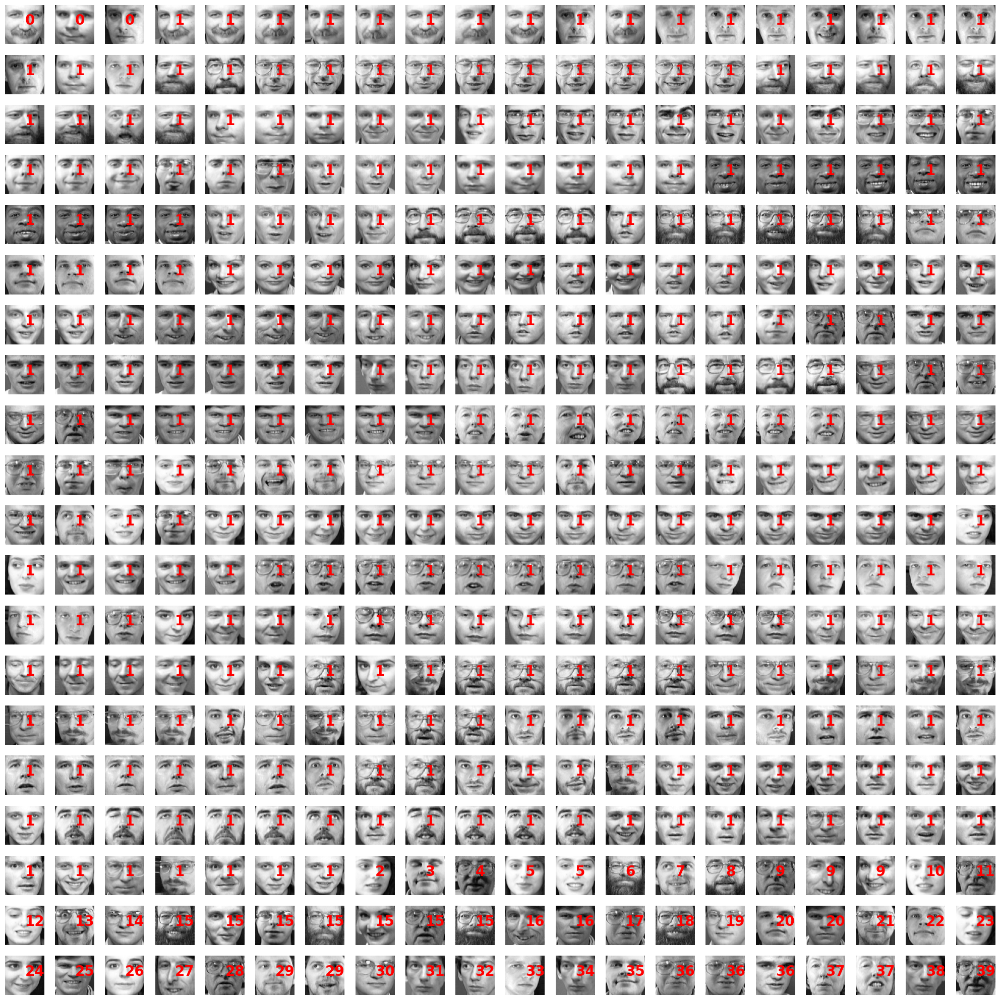

In [35]:
# Spectral Clustering using RBF and Ratio Cut result

fig = plt.figure(figsize=(20,20))
indx = 1
for img in new_images:
    img = np.array(img).reshape(64,64)
    ax = fig.add_subplot(20,20,indx)
    ax.imshow(img, cmap = 'gray')
    ax.grid(False)
    ax.axis('off')
    # add label aka target aka cluster 
    ax.text(img.shape[0]/2, img.shape[1]/2, str(new_targets[indx-1]), fontsize = 20, color = 'red', fontweight='bold')
    indx+=1
fig.tight_layout()
plt.show()

## <font color = 'Blue'> RBF (Normalized Cut)

In [36]:
# Result , containg data, target and estimated cluster. 
spectral_results_rbf_normalized_cut = pd.DataFrame(
    {'data': data.tolist(),'y' : target, 'yhat': Kmean_normalized_cut_rbf.labels_}
    )

# Sort the result so visulization is simpler 
# Sort based on the y estimate aka yhat 
# Result is the new cluster visualization
spectral_results_rbf_normalized_cut = spectral_results_rbf_normalized_cut.sort_values(by='yhat')
new_images = spectral_results_rbf_normalized_cut['data']
new_targets = np.array(spectral_results_rbf_normalized_cut['yhat'])

In [37]:
# rand score
spectral_rbf_normalized_cut_rc = metrics.rand_score(target, Kmean_normalized_cut_rbf.labels_)

# Normalized Mutual Information
spectral_rbf_normalized_cut_nmi = metrics.normalized_mutual_info_score(target, Kmean_normalized_cut_rbf.labels_)

# Fowlkes-Mallows scores
spectral_rbf_normalized_cut_fm  = metrics.fowlkes_mallows_score(target, Kmean_normalized_cut_rbf.labels_)


print(f'rand score : {spectral_rbf_normalized_cut_rc}')
print(f'Normalized Mutual Information score : {spectral_rbf_normalized_cut_nmi}')
print(f'Fowlkes-Mallows score : {spectral_rbf_normalized_cut_fm}')

rand score : 0.9419924812030075
Normalized Mutual Information score : 0.4000712655186186
Fowlkes-Mallows score : 0.045718981718438016


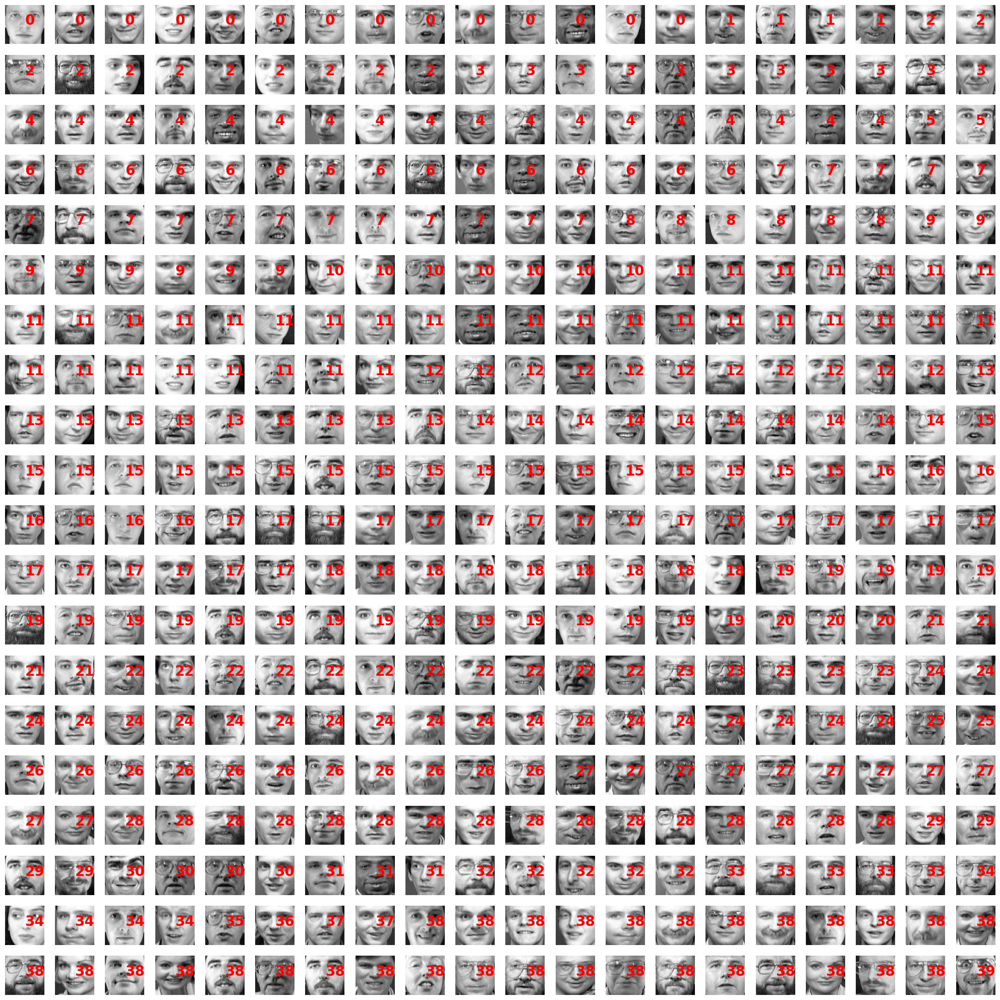

In [38]:
# Spectral Clustering using RBF and Ratio Cut result

fig = plt.figure(figsize=(20,20))
indx = 1
for img in new_images:
    img = np.array(img).reshape(64,64)
    ax = fig.add_subplot(20,20,indx)
    ax.imshow(img, cmap = 'gray')
    ax.grid(False)
    ax.axis('off')
    # add label aka target aka cluster 
    ax.text(img.shape[0]/2, img.shape[1]/2, str(new_targets[indx-1]), fontsize = 20, color = 'red', fontweight='bold')
    indx+=1
fig.tight_layout()
plt.show()

## <font color = 'Blue'> KNN (Ratio Cut)

In [39]:
# Result , containg data, target and estimated cluster. 
spectral_results_KNN_ratio_cut = pd.DataFrame(
    {'data': data.tolist(),'y' : target, 'yhat': Kmean_ratio_cut_knn.labels_}
    )

# Sort the result so visulization is simpler 
# Sort based on the y estimate aka yhat 
# Result is the new cluster visualization
spectral_results_KNN_ratio_cut = spectral_results_KNN_ratio_cut.sort_values(by='yhat')
new_images = spectral_results_KNN_ratio_cut['data']
new_targets = np.array(spectral_results_KNN_ratio_cut['yhat'])

In [40]:
# rand score
spectral_knn_ratio_cut_rc = metrics.rand_score(target, Kmean_ratio_cut_knn.labels_)

# Normalized Mutual Information
spectral_knn_ratio_cut_nmi = metrics.normalized_mutual_info_score(target, Kmean_ratio_cut_knn.labels_)

# Fowlkes-Mallows scores
spectral_knn_ratio_cut_fm  = metrics.fowlkes_mallows_score(target, Kmean_ratio_cut_knn.labels_)


print(f'rand score : {spectral_knn_ratio_cut_rc}')
print(f'Normalized Mutual Information score : {spectral_knn_ratio_cut_nmi}')
print(f'Fowlkes-Mallows score : {spectral_knn_ratio_cut_fm}')

rand score : 0.6811779448621554
Normalized Mutual Information score : 0.29141099284180455
Fowlkes-Mallows score : 0.09482725414229129


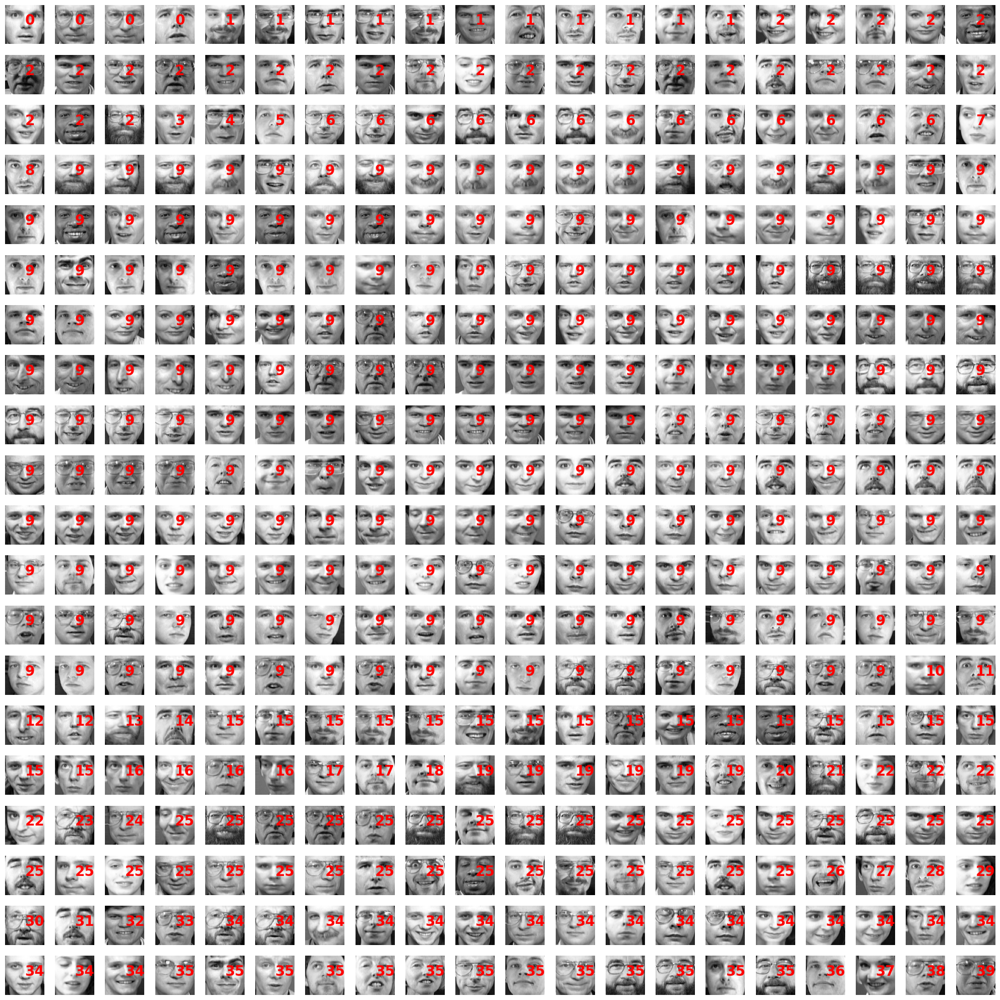

In [41]:
# Spectral Clustering using RBF and Ratio Cut result

fig = plt.figure(figsize=(20,20))
indx = 1
for img in new_images:
    img = np.array(img).reshape(64,64)
    ax = fig.add_subplot(20,20,indx)
    ax.imshow(img, cmap = 'gray')
    ax.grid(False)
    ax.axis('off')
    # add label aka target aka cluster 
    ax.text(img.shape[0]/2, img.shape[1]/2, str(new_targets[indx-1]), fontsize = 20, color = 'red', fontweight='bold')
    indx+=1
fig.tight_layout()
plt.show()

## <font color = 'Blue'> KNN (Normalized Cut)

In [42]:
# Result , containg data, target and estimated cluster. 
spectral_results_knn_normalized_cut = pd.DataFrame(
    {'data': data.tolist(),'y' : target, 'yhat': Kmean_normalized_cut_knn.labels_}
    )

# Sort the result so visulization is simpler 
# Sort based on the y estimate aka yhat 
# Result is the new cluster visualization
spectral_results_knn_normalized_cut = spectral_results_knn_normalized_cut.sort_values(by='yhat')
new_images = spectral_results_knn_normalized_cut['data']
new_targets = np.array(spectral_results_knn_normalized_cut['yhat'])

In [43]:
# rand score
spectral_knn_normalized_cut_rc = metrics.rand_score(target, Kmean_normalized_cut_knn.labels_)

# Normalized Mutual Information
spectral_knn_normalized_cut_nmi = metrics.normalized_mutual_info_score(target, Kmean_normalized_cut_knn.labels_)

# Fowlkes-Mallows scores
spectral_knn_normalized_cut_fm  = metrics.fowlkes_mallows_score(target, Kmean_normalized_cut_knn.labels_)


print(f'rand score : {spectral_knn_normalized_cut_rc}')
print(f'Normalized Mutual Information score : {spectral_knn_normalized_cut_nmi}')
print(f'Fowlkes-Mallows score : {spectral_knn_normalized_cut_fm}')

rand score : 0.8260275689223058
Normalized Mutual Information score : 0.3291353102300702
Fowlkes-Mallows score : 0.07963937752686835


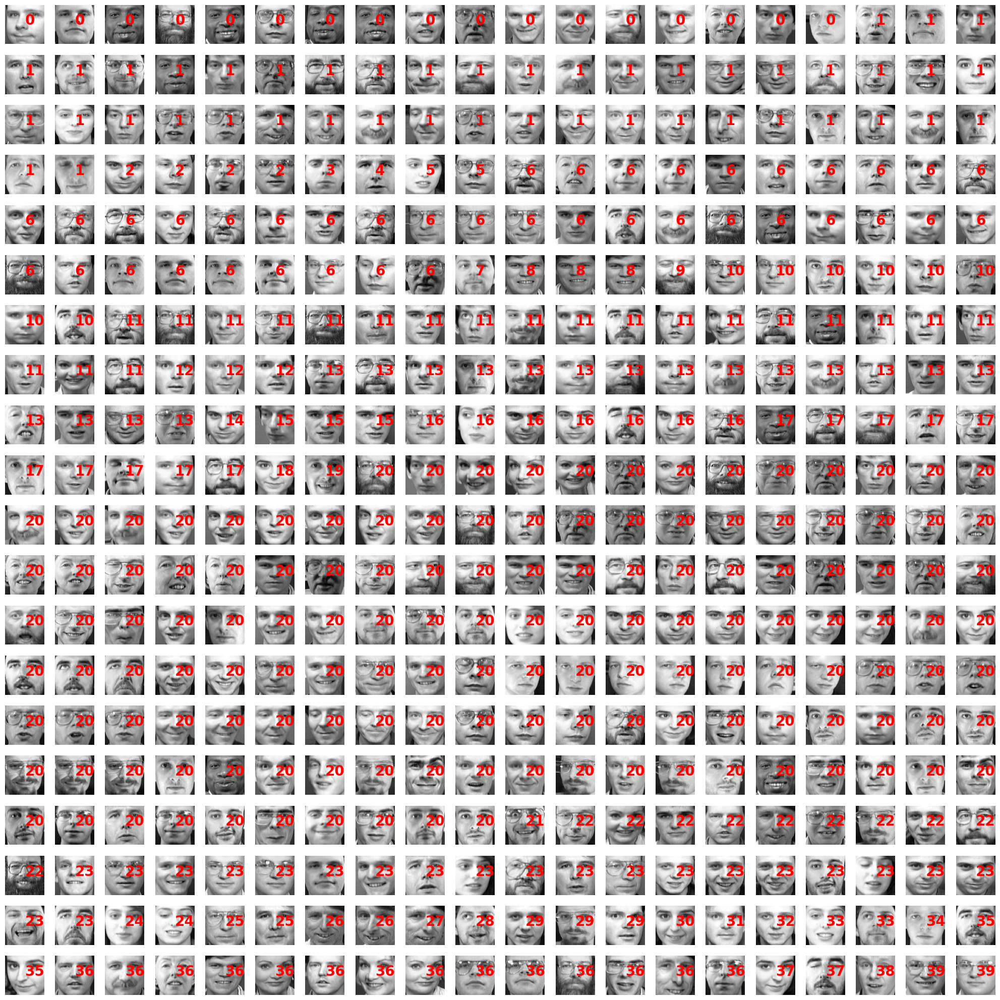

In [44]:
# Spectral Clustering using RBF and Ratio Cut result

fig = plt.figure(figsize=(20,20))
indx = 1
for img in new_images:
    img = np.array(img).reshape(64,64)
    ax = fig.add_subplot(20,20,indx)
    ax.imshow(img, cmap = 'gray')
    ax.grid(False)
    ax.axis('off')
    # add label aka target aka cluster 
    ax.text(img.shape[0]/2, img.shape[1]/2, str(new_targets[indx-1]), fontsize = 20, color = 'red', fontweight='bold')
    indx+=1
fig.tight_layout()
plt.show()

## <font color = 'Blue'> OMP (Ratio Cut)

In [45]:
# Result , containg data, target and estimated cluster. 
spectral_results_omp_ratio_cut = pd.DataFrame(
    {'data': data.tolist(),'y' : target, 'yhat': Kmean_ratio_cut_omp.labels_}
    )

# Sort the result so visulization is simpler 
# Sort based on the y estimate aka yhat 
# Result is the new cluster visualization
spectral_results_omp_ratio_cut = spectral_results_omp_ratio_cut.sort_values(by='yhat')
new_images = spectral_results_omp_ratio_cut['data']
new_targets = np.array(spectral_results_omp_ratio_cut['yhat'])

In [46]:
# rand score
spectral_omp_ratio_cut_rc = metrics.rand_score(target, Kmean_ratio_cut_omp.labels_)

# Normalized Mutual Information
spectral_omp_ratio_cut_nmi = metrics.normalized_mutual_info_score(target, Kmean_ratio_cut_omp.labels_)

# Fowlkes-Mallows scores
spectral_omp_ratio_cut_fm  = metrics.fowlkes_mallows_score(target, Kmean_ratio_cut_omp.labels_)


print(f'rand score : {spectral_omp_ratio_cut_rc}')
print(f'Normalized Mutual Information score : {spectral_omp_ratio_cut_nmi}')
print(f'Fowlkes-Mallows score : {spectral_omp_ratio_cut_fm}')

rand score : 0.5302882205513785
Normalized Mutual Information score : 0.2635266960937465
Fowlkes-Mallows score : 0.10838083133417777


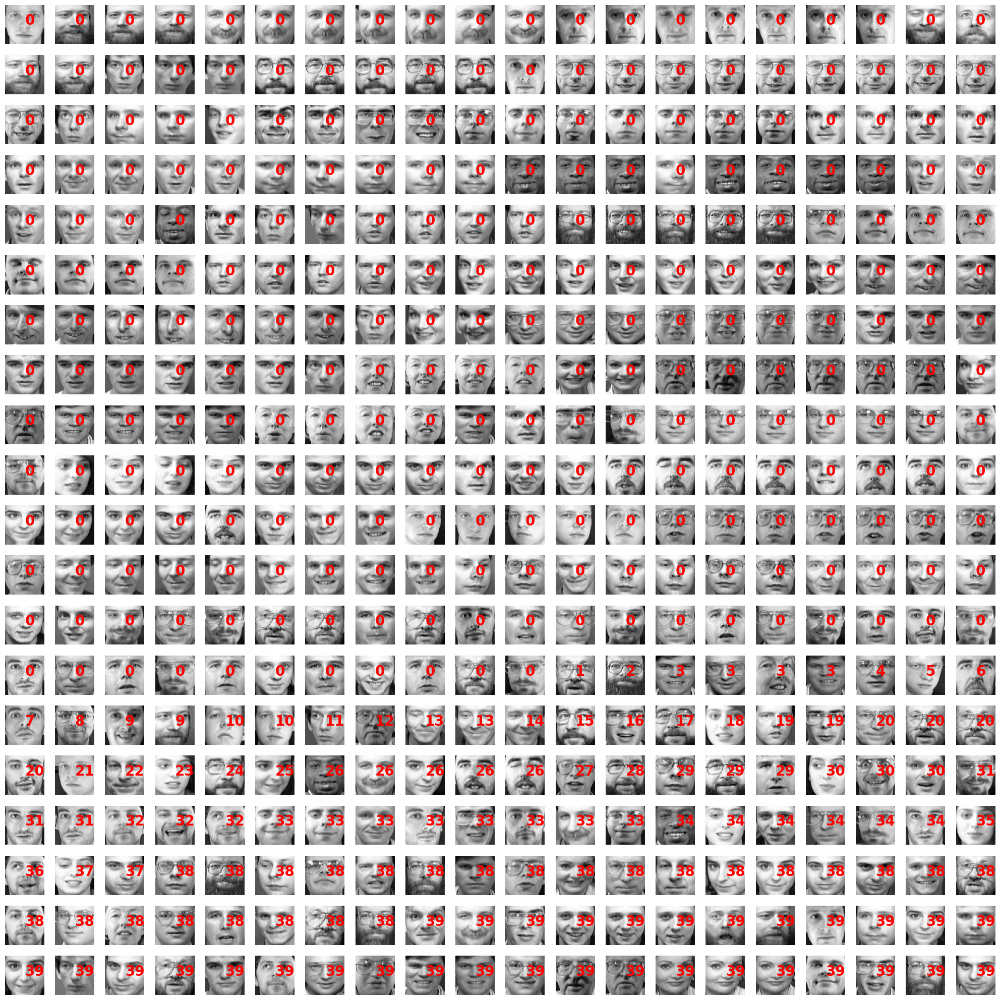

In [47]:
# Spectral Clustering using RBF and Ratio Cut result

fig = plt.figure(figsize=(20,20))
indx = 1
for img in new_images:
    img = np.array(img).reshape(64,64)
    ax = fig.add_subplot(20,20,indx)
    ax.imshow(img, cmap = 'gray')
    ax.grid(False)
    ax.axis('off')
    # add label aka target aka cluster 
    ax.text(img.shape[0]/2, img.shape[1]/2, str(new_targets[indx-1]), fontsize = 20, color = 'red', fontweight='bold')
    indx+=1
fig.tight_layout()
plt.show()

## <font color = 'Blue'> OMP (Normalized Cut)

In [48]:
# Result , containg data, target and estimated cluster. 
spectral_results_omp_normalized_cut = pd.DataFrame(
    {'data': data.tolist(),'y' : target, 'yhat': Kmean_normalized_cut_omp.labels_}
    )

# Sort the result so visulization is simpler 
# Sort based on the y estimate aka yhat 
# Result is the new cluster visualization
spectral_results_omp_normalized_cut = spectral_results_omp_normalized_cut.sort_values(by='yhat')
new_images = spectral_results_omp_normalized_cut['data']
new_targets = np.array(spectral_results_omp_normalized_cut['yhat'])

In [49]:
# rand score
spectral_omp_normalized_cut_rc = metrics.rand_score(target, Kmean_normalized_cut_omp.labels_)

# Normalized Mutual Information
spectral_omp_normalized_cut_nmi = metrics.normalized_mutual_info_score(target, Kmean_normalized_cut_omp.labels_)

# Fowlkes-Mallows scores
spectral_omp_normalized_cut_fm  = metrics.fowlkes_mallows_score(target, Kmean_normalized_cut_omp.labels_)


print(f'rand score : {spectral_omp_normalized_cut_rc}')
print(f'Normalized Mutual Information score : {spectral_omp_normalized_cut_nmi}')
print(f'Fowlkes-Mallows score : {spectral_omp_normalized_cut_fm}')

rand score : 0.9254385964912281
Normalized Mutual Information score : 0.4606815464183755
Fowlkes-Mallows score : 0.11088435374149659


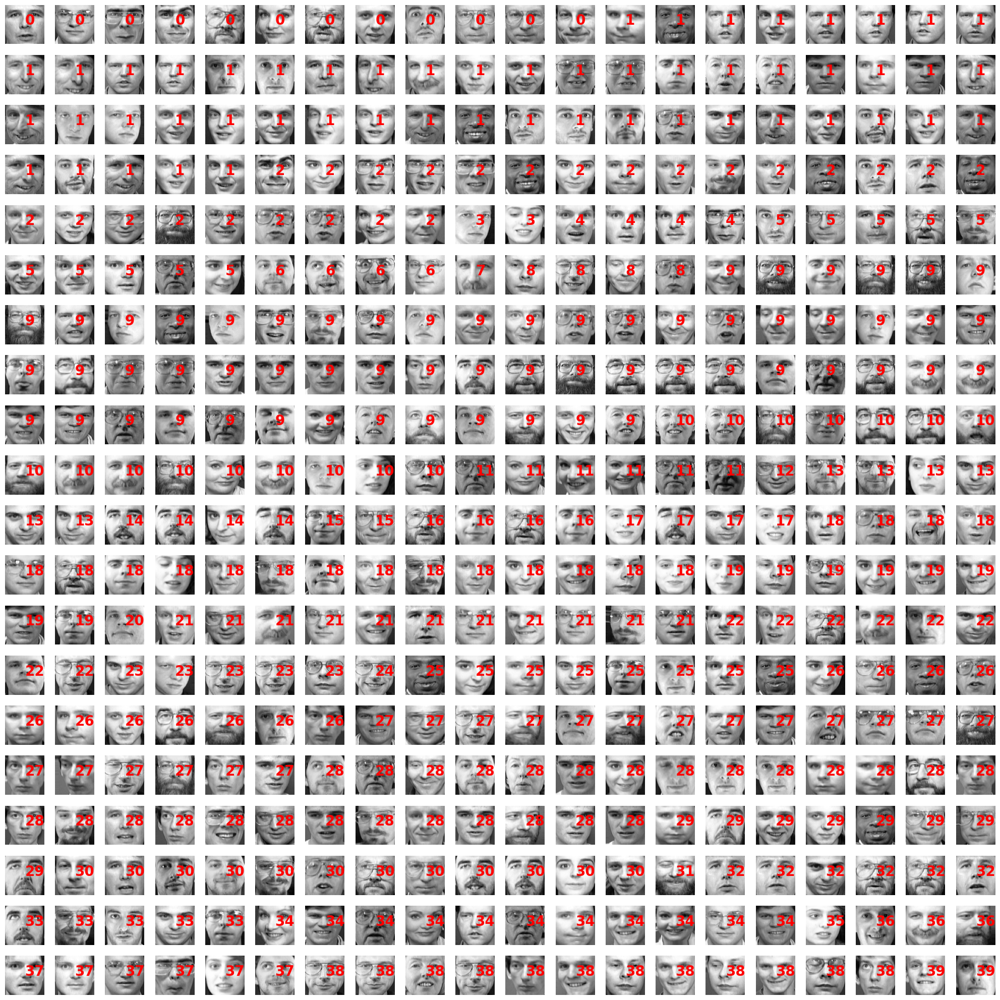

In [50]:
# Spectral Clustering using RBF and Ratio Cut result

fig = plt.figure(figsize=(20,20))
indx = 1
for img in new_images:
    img = np.array(img).reshape(64,64)
    ax = fig.add_subplot(20,20,indx)
    ax.imshow(img, cmap = 'gray')
    ax.grid(False)
    ax.axis('off')
    # add label aka target aka cluster 
    ax.text(img.shape[0]/2, img.shape[1]/2, str(new_targets[indx-1]), fontsize = 20, color = 'red', fontweight='bold')
    indx+=1
fig.tight_layout()
plt.show()